**Connect to Elasticsearch**

In [46]:
from pprint import pprint
from elasticsearch import Elasticsearch

es = Elasticsearch("http://localhost:9200")

client_info = es.info()

print("Connected to Elasticsearch!")

pprint(client_info.body)

Connected to Elasticsearch!
{'cluster_name': 'docker-cluster',
 'cluster_uuid': 'T1HeaWnRTOqX_BBgREVVbA',
 'name': '64c49e436740',
 'tagline': 'You Know, for Search',
 'version': {'build_date': '2025-10-21T10:06:21.288851013Z',
             'build_flavor': 'default',
             'build_hash': '25d88452371273dd27356c98598287b669a03eae',
             'build_snapshot': False,
             'build_type': 'docker',
             'lucene_version': '10.3.1',
             'minimum_index_compatibility_version': '8.0.0',
             'minimum_wire_compatibility_version': '8.19.0',
             'number': '9.2.0'}}


**Creating Index**

In [47]:
es.indices.delete(index="my_index", ignore_unavailable=True) 
es.indices.create(
    index="my_index",
    mappings={
        "properties": {
            "timestamp": {"type": "date"},
            "value": {"type": "float"},
            "category": {"type": "keyword"},
            "description": {"type": "text"},
            "id": {'type': "keyword"}
        }
    }
)

ObjectApiResponse({'acknowledged': True, 'shards_acknowledged': True, 'index': 'my_index'})

Generating fake data
The base documents will be duplicated to create a total of 100,000 documents. This is done to compare the from/size method with the search_after method.

In [48]:
base_documents = [
    {
        "category": "A",
        "value": 100,
        "description": "First sample document"
    },
    {
        "category": "B",
        "value": 200,
        "description": "Second sample document"
    },
    {
        "category": "C",
        "value": 300,
        "description": "Third sample document"
    },
    {
        "category": "D",
        "value": 400,
        "description": "Fourth sample document"
    },
    {
        "category": "E",
        "value": 500,
        "description": "Fifth sample document"
    }
]

The generate_bulk_data function determines the number of times to duplicate the base documents to achieve a target of 100,000 documents. It also assigns a unique _id, modifies the value field randomly, and appends a timestamp to each duplicated document.

In [49]:
import random 
from datetime import datetime, timedelta


def generate_bulk_data(base_documents, target_size=100_000):
    documents = []
    base_count = len(base_documents)
    duplication_needed = target_size // base_count

    base_timestamp = datetime.now()
    len_doc = 0

    for i in range(duplication_needed):
        for document in base_documents:
            new_doc = document.copy()
            new_doc["id"] = f"doc_{len_doc}"
            new_doc["timestamp"] = (base_timestamp - timedelta(minutes=len_doc)).isoformat()
            new_doc["value"] = document["value"] + random.uniform(-10, 10)

            documents.append(new_doc)
            len_doc += 1
        
    return documents, len_doc

documents, len_documents = generate_bulk_data(base_documents)
documents[99999:]

[{'category': 'E',
  'value': 496.02556106623535,
  'description': 'Fifth sample document',
  'id': 'doc_99999',
  'timestamp': '2025-08-26T08:12:17.054539'}]

In [50]:
len_documents

100000

**Indexing**

In [51]:
from tqdm import tqdm 

operations = []

for document in tqdm(documents, total=len_documents):
    operations.append({"index": {"_index": "my_index"}}) # action 
    operations.append(document)

response = es.bulk(operations=operations)
pprint(response.body)

100%|██████████| 100000/100000 [00:02<00:00, 34055.87it/s]


{'errors': False,
 'items': [{'index': {'_id': 'lXHFSZoBX8WfhiD1tYKR',
                      '_index': 'my_index',
                      '_primary_term': 1,
                      '_seq_no': 0,
                      '_shards': {'failed': 0, 'successful': 1, 'total': 2},
                      '_version': 1,
                      'result': 'created',
                      'status': 201}},
           {'index': {'_id': 'lnHFSZoBX8WfhiD1tYKY',
                      '_index': 'my_index',
                      '_primary_term': 1,
                      '_seq_no': 1,
                      '_shards': {'failed': 0, 'successful': 1, 'total': 2},
                      '_version': 1,
                      'result': 'created',
                      'status': 201}},
           {'index': {'_id': 'l3HFSZoBX8WfhiD1tYKY',
                      '_index': 'my_index',
                      '_primary_term': 1,
                      '_seq_no': 2,
                      '_shards': {'failed': 0, 'successful': 1, '

In [52]:
es.indices.refresh(index="my_index")

count = es.count(index="my_index")["count"]

print(f"Indexed {count} documents.")

Indexed 100000 documents.


## From / Size method
To use the from/size method, include two parameters in your query: from, which specifies the number of documents to skip, and size, which tells Elasticsearch how many documents to return.

In [53]:
response = es.search(
    index="my_index", 
    body={
        "from": 0,
        "size": 10, 
        "sort": [
            {"timestamp": "desc"},
            {"id": "desc"}
        ]
    }
)

hits = response["hits"]["hits"]

for hit in hits:
    print(f"ID: {hit["_source"]["id"]}")

ID: doc_0
ID: doc_1
ID: doc_2
ID: doc_3
ID: doc_4
ID: doc_5
ID: doc_6
ID: doc_7
ID: doc_8
ID: doc_9


To retrieve the next batch of documents, adjust the from parameter from 0 to 10.

In [54]:
response = es.search(
    index="my_index",
    body={
        "from": 10,
        "size": 10,
        "sort": [
            {"timestamp": "desc"},
            {"id": "desc"}
        ]
    }
)

hits = response["hits"]["hits"]

for hit in hits:
    print(f"ID: {hit['_source']['id']}")

ID: doc_10
ID: doc_11
ID: doc_12
ID: doc_13
ID: doc_14
ID: doc_15
ID: doc_16
ID: doc_17
ID: doc_18
ID: doc_19


### Search after method
To use the search_after method, include the following parameters in your query:

1. size: Specifies the number of documents to retrieve in each batch, similar to the size parameter in from/size.
2. sort: The search_after method requires specifying one or more fields to sort the results, such as timestamp or id. Sorting ensures a consistent order for navigating through result pages.

In [55]:
response = es.search(
    index="my_index", 
    body={
        "size": 10, 
        "sort": [
            {"timestamp": "desc"},
            {"id": "desc"}
        ]
    }
)

hits = response["hits"]["hits"]
for hit in hits:
    print(f"ID: {hit['_source']['id']}")
    print(f"Sort values: {hit['sort']}")
    print()

ID: doc_0
Sort values: [1762195877054, 'doc_0']

ID: doc_1
Sort values: [1762195817054, 'doc_1']

ID: doc_2
Sort values: [1762195757054, 'doc_2']

ID: doc_3
Sort values: [1762195697054, 'doc_3']

ID: doc_4
Sort values: [1762195637054, 'doc_4']

ID: doc_5
Sort values: [1762195577054, 'doc_5']

ID: doc_6
Sort values: [1762195517054, 'doc_6']

ID: doc_7
Sort values: [1762195457054, 'doc_7']

ID: doc_8
Sort values: [1762195397054, 'doc_8']

ID: doc_9
Sort values: [1762195337054, 'doc_9']



To retrieve the next batch of documents using search_after, you’ll pass the sort values from the last document of the previous batch to the search_after parameter in the subsequent query.

In [56]:
last_sort_values = hits[-1]["sort"]
last_sort_values

[1762195337054, 'doc_9']

In [57]:
response = es.search(
    index="my_index", 
    body={
        "size": 10,
        "sort": [
            {"timestamp": "desc"},
            {"id": "desc"}
        ],
        "search_after": last_sort_values
    }
)

hits = response["hits"]["hits"]

for hit in hits:
    print(f"ID: {hit['_source']['id']}")
    print(f"Sort values: {hit['sort']}")
    print()
    

ID: doc_10
Sort values: [1762195277054, 'doc_10']

ID: doc_11
Sort values: [1762195217054, 'doc_11']

ID: doc_12
Sort values: [1762195157054, 'doc_12']

ID: doc_13
Sort values: [1762195097054, 'doc_13']

ID: doc_14
Sort values: [1762195037054, 'doc_14']

ID: doc_15
Sort values: [1762194977054, 'doc_15']

ID: doc_16
Sort values: [1762194917054, 'doc_16']

ID: doc_17
Sort values: [1762194857054, 'doc_17']

ID: doc_18
Sort values: [1762194797054, 'doc_18']

ID: doc_19
Sort values: [1762194737054, 'doc_19']



### Benchmark
In this benchmark, we assess the performance of two pagination methods, from/size and search_after, by measuring and comparing their response times. We capture the response time of each method for multiple pages, plot the results, and calculate relevant statistics to provide insights.

1. From / Size test

In [58]:
import time 
from tqdm import tqdm 

def test_from_size_pagination(es, index_name, page_size=100, max_pages=50):
    timings = []

    for page in tqdm(range(max_pages)):
        start_time = time.time()

        _ = es.search(
            index=index_name, 
            body={
                "from": page * page_size,
                "size": page_size,
                "sort": [
                    {"timestamp": "desc"},
                    {"timestamp": "desc"}
                ]
            }
        )

        end_time = time.time()
        final_time = (end_time - start_time) * 1000

        timings.append((page+1, final_time))
    
    return timings

When attempting to retrieve more than 10,000 documents, Elasticsearch returns an error indicating that the from / size method cannot handle this request.

In [59]:
from_size_timings = test_from_size_pagination(
    es=es,
    index_name="my_index",
    page_size=1000,
    max_pages=50
)

 20%|██        | 10/50 [00:01<00:04,  9.78it/s]


BadRequestError: BadRequestError(400, 'search_phase_execution_exception', 'Result window is too large, from + size must be less than or equal to: [10000] but was [11000]. See the scroll api for a more efficient way to request large data sets. This limit can be set by changing the [index.max_result_window] index level setting.', Result window is too large, from + size must be less than or equal to: [10000] but was [11000]. See the scroll api for a more efficient way to request large data sets. This limit can be set by changing the [index.max_result_window] index level setting.)

Let's reduce the page_size to avoid this problem.

In [67]:
from_size_timings = test_from_size_pagination(
    es=es,
    index_name="my_index",
    page_size=200,
    max_pages=50
)

100%|██████████| 50/50 [00:03<00:00, 15.30it/s]


2. Search after test

In [62]:
def test_search_after_pagination(es, index_name, page_size=100, max_pages=50):
    timings = []

    search_after = None 

    for page in tqdm(range(max_pages)):
        start_time = time.time()

        body = {
            "size": page_size,
            "sort": [
                {"timestamp": "desc"},
                {"id": "desc"}
            ]
        }

        if search_after:
            body["search_after"] = search_after
        
        response = es.search(
            index=index_name,
            body=body
        )

        hits = response["hits"]["hits"]

        if hits:
            search_after = hits[-1]["sort"]

        end_time = time.time()

        final_time = (end_time - start_time) * 1000

        timings.append((page + 1, final_time))

    return timings 
        

In [68]:
search_after_timings = test_search_after_pagination(
    es, "my_index", page_size=200, max_pages=50)

100%|██████████| 50/50 [00:03<00:00, 14.72it/s]


3. Plotting & statistics

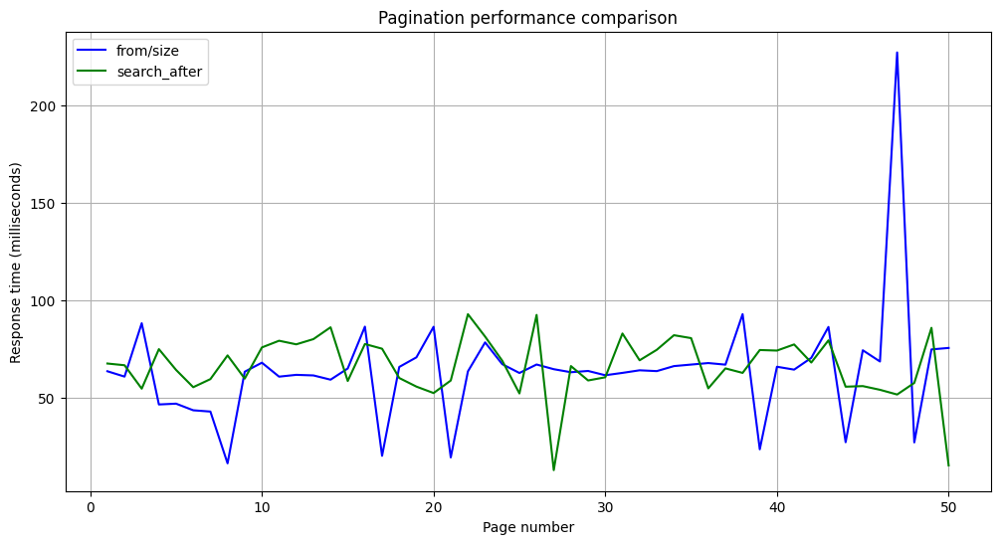

In [69]:
import matplotlib.pyplot as plt


def plot_comparison(from_size_timings, search_after_timings):
    plt.figure(figsize=(12, 6))

    pages_from_size, times_from_size = zip(*from_size_timings)
    pages_search_after, times_search_after = zip(*search_after_timings)

    plt.plot(pages_from_size, times_from_size, 'b-', label='from/size')
    plt.plot(pages_search_after, times_search_after,
             'g-', label='search_after')

    plt.xlabel('Page number')
    plt.ylabel('Response time (milliseconds)')
    plt.title('Pagination performance comparison')
    plt.legend()
    plt.grid(True)
    plt.show()


plot_comparison(from_size_timings, search_after_timings)


The search_after method performs more efficiently, especially for deep pagination, due to its stable response time. In contrast, from/size may be suitable for shallow pagination but becomes inefficient as the page depth grows.

In [70]:
def calculate_stats(from_size_timings, search_after_timings):
    _, times_from_size = zip(*from_size_timings)
    _, times_search_after = zip(*search_after_timings)

    stats = {
        'from_size': {
            'avg_time': sum(times_from_size) / len(times_from_size),
            'max_time': max(times_from_size),
            'min_time': min(times_from_size)
        },
        'search_after': {
            'avg_time': sum(times_search_after) / len(times_search_after),
            'max_time': max(times_search_after),
            'min_time': min(times_search_after)
        }
    }
    return stats


stats = calculate_stats(from_size_timings, search_after_timings)

print("\nPerformance statistics:")
print("\n- From/Size pagination:")
print(f"Average time: {stats['from_size']['avg_time']:.3f} milliseconds")
print(f"Maximum time: {stats['from_size']['max_time']:.3f} milliseconds")
print(f"Minimum time: {stats['from_size']['min_time']:.3f} milliseconds")

print("\n- Search after pagination:")
print(f"Average time: {stats['search_after']['avg_time']:.3f} milliseconds")
print(f"Maximum time: {stats['search_after']['max_time']:.3f} milliseconds")
print(f"Minimum time: {stats['search_after']['min_time']:.3f} milliseconds")


Performance statistics:

- From/Size pagination:
Average time: 64.706 milliseconds
Maximum time: 227.074 milliseconds
Minimum time: 16.608 milliseconds

- Search after pagination:
Average time: 66.571 milliseconds
Maximum time: 93.003 milliseconds
Minimum time: 13.122 milliseconds


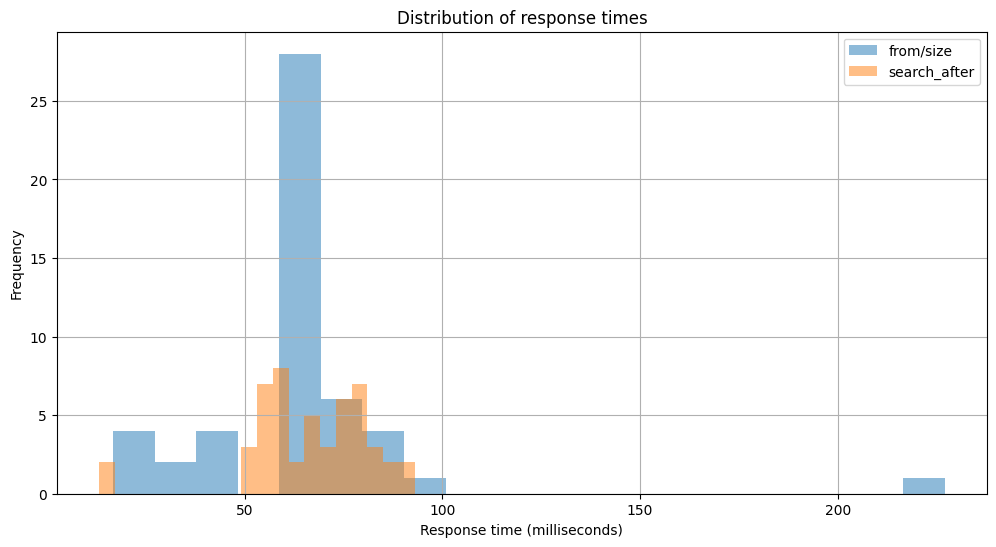

In [71]:
plt.figure(figsize=(12, 6))
_, times_from_size = zip(*from_size_timings)
_, times_search_after = zip(*search_after_timings)

plt.hist(times_from_size, alpha=0.5, label='from/size', bins=20)
plt.hist(times_search_after, alpha=0.5, label='search_after', bins=20)
plt.xlabel('Response time (milliseconds)')
plt.ylabel('Frequency')
plt.title('Distribution of response times')
plt.legend()
plt.grid(True)
plt.show()

Based on this histogram visualization, the search_after approach (shown in orange) demonstrates consistently faster response times clustered around 2-5 milliseconds, while the from/size method (in blue) shows a wider distribution of response times spreading up to 16 milliseconds, suggesting that search_after provides more predictable and generally better performance for pagination.

In [72]:
def calculate_degradation(timings):
    first_page_time = timings[0][1]
    last_page_time = timings[-1][1]
    degradation_factor = last_page_time / first_page_time
    return degradation_factor


from_size_degradation = calculate_degradation(from_size_timings)
search_after_degradation = calculate_degradation(search_after_timings)

print("\nPerformance degradation (Last page time / First page time):")
print(f"- From/Size degradation factor   : {from_size_degradation:.2f}x")
print(f"- Search after degradation factor: {search_after_degradation:.2f}x")


Performance degradation (Last page time / First page time):
- From/Size degradation factor   : 1.19x
- Search after degradation factor: 0.23x


Performance degradation (Last page time / First page time):
- From/Size degradation factor   : 2.26x
- Search after degradation factor: 1.16x
The search_after method is far superior in maintaining a stable response time, even for large page numbers. In contrast, from/size exhibits significant performance degradation, making it less suitable for deep pagination.

### Conclusion
For larger indexes, it's recommended to use the search_after method. For smaller indexes, both methods work well.